In [1]:
################################################################################
####################    Regression: Linear Regression    #######################
################################################################################
### Load necessary modules -------------------------------
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import math
plt.style.use('ggplot')
from sklearn.feature_selection import RFECV
import RegressionTools as RT
import numpy as np
from pygam import LinearGAM
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.metrics import mean_squared_error
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn import set_config
set_config(display='diagram')

In [2]:
### Load file --------------------------------------------
df = pd.read_csv('DAILY_DEMAND.csv', sep = ";")
df.head()

,fecha,DEM,WD,TEMP
0,01/07/2007,590.803564,7,23.100
1,02/07/2007,738.568372,1,22.650
2,03/07/2007,774.875745,2,23.275
3,04/07/2007,783.546441,3,24.375
4,05/07/2007,771.248135,4,21.675


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1980 entries, 0 to 1979
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   fecha   1980 non-null   object 
 1   DEM     1980 non-null   float64
 2   WD      1980 non-null   int64  
 3   TEMP    1980 non-null   float64
dtypes: float64(2), int64(1), object(1)
memory usage: 62.0+ KB


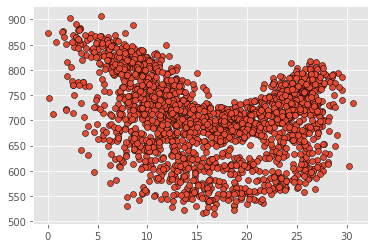

In [4]:
# Output variable (TMIN MADRID-RETIRO)
plt.scatter(x=df.TEMP, y=df.DEM, edgecolor='black')
plt.show()

In [5]:
### Convert necessary variable to factor
df.WD = df.WD.astype('category')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1980 entries, 0 to 1979
Data columns (total 4 columns):
 #   Column  Non-Null Count  Dtype   
---  ------  --------------  -----   
 0   fecha   1980 non-null   object  
 1   DEM     1980 non-null   float64 
 2   WD      1980 non-null   category
 3   TEMP    1980 non-null   float64 
dtypes: category(1), float64(2), object(1)
memory usage: 48.8+ KB


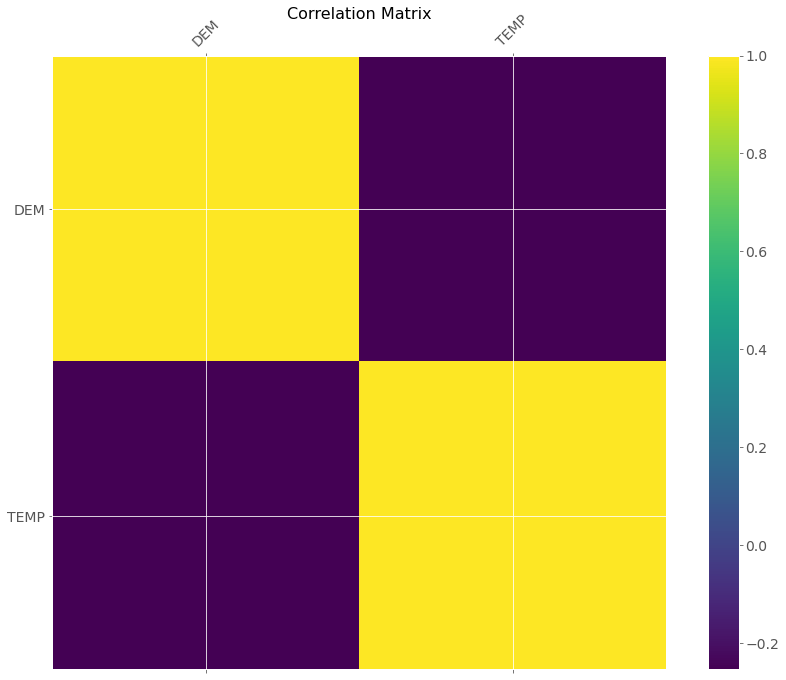

In [6]:
#correlation plot of numeric variables
f = plt.figure(figsize=(15, 11))
plt.matshow(df.select_dtypes(include=['int64','float64']).corr(), fignum=f.number)
plt.xticks(range(df.select_dtypes(include=['int64','float64']).shape[1]), df.select_dtypes(include=['int64','float64']).columns, fontsize=14, rotation=45)
plt.yticks(range(df.select_dtypes(include=['int64','float64']).shape[1]), df.select_dtypes(include=['int64','float64']).columns, fontsize=14)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16)
plt.show()

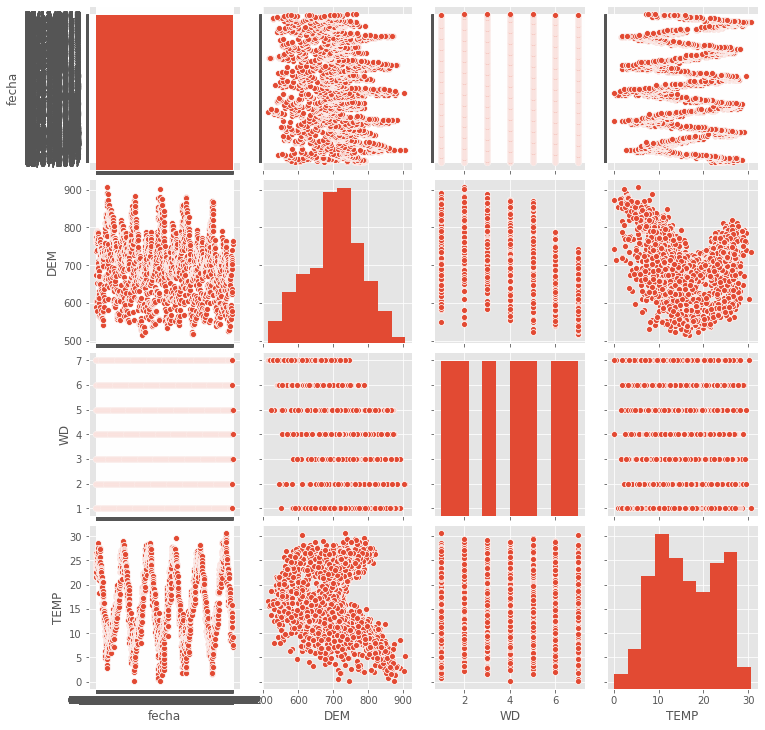

In [7]:
### Exploratory analysis -------------------------------------------------------------------------------------
sns.pairplot(df, vars=df.columns.values.tolist())
plt.show()

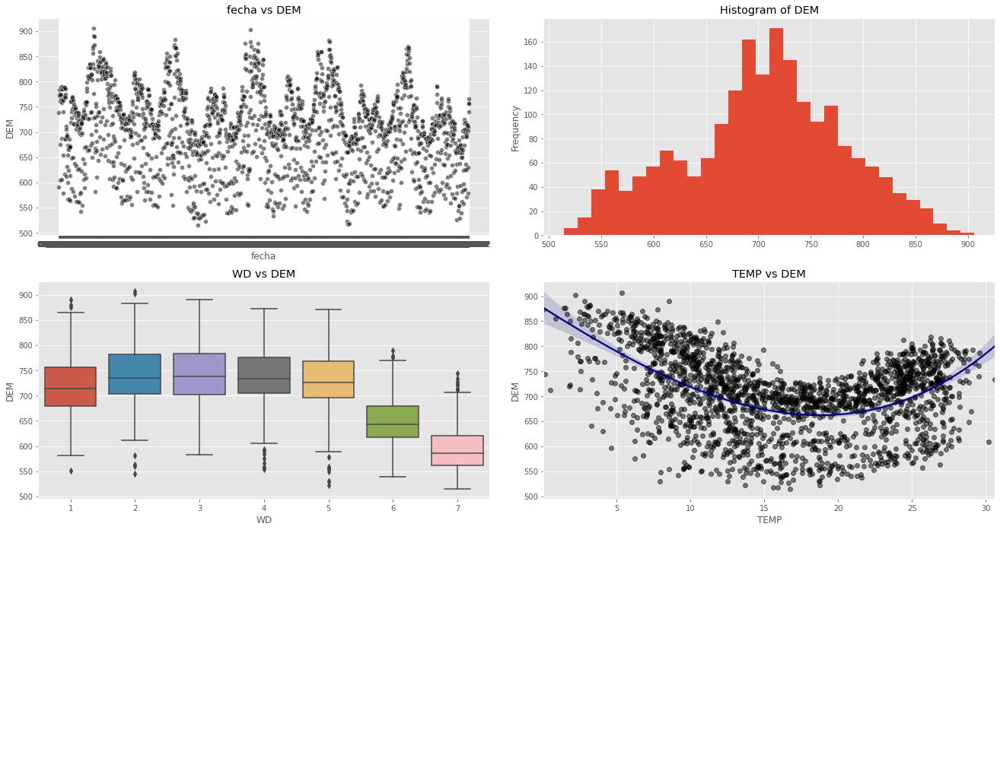

In [8]:
#To analyze in greater detail the relation between inputs and output, use PlotDataframe function
RT.PlotDataframe(df, 'DEM', spline_degree=3)

In [9]:
X = df.loc[:, [name not in ['fecha','DEM'] for name in df.columns.values.tolist()]]
y = df['DEM']
## Divide the data into training and test sets ---------------------------------------------------
## Create random 80/20 % split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 5)

## Create dataset to store model predictions
dfTR_eval = X_train.copy()
dfTR_eval['DEM'] = y_train
dfTS_eval = X_test.copy()
dfTS_eval['DEM'] = y_test

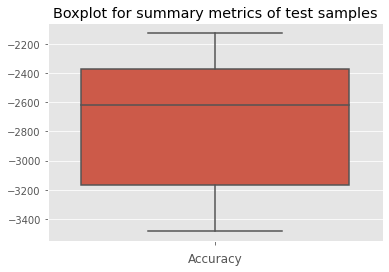

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TEMP']),
                                                                        ('cat',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='constant')),
                                                                                         ('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['WD'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={}, scoring='neg_mean_squared_error')

In [10]:
#-------------------------------------------------------------------------------------------------
#------------------------------- Linear Regression MODEL -----------------------------------------
#-------------------------------------------------------------------------------------------------
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = X_train.select_dtypes(include=['category']).columns.values.tolist()
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])

# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='neg_mean_squared_error', # RMSE https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
LR_fit.fit(X_train[numeric_features + categorical_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR1 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR_fit

In [11]:
RT.summaryLinReg(LR_fit.best_estimator_, X_train[numeric_features + categorical_features], y_train)  #information about the model trained

Residuals:
         Min         1Q   Median         3Q         Max
0 -213.16367 -34.466381 -0.80721  37.722019  131.888832

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.551
Model:                            OLS   Adj. R-squared:                  0.549
Method:                 Least Squares   F-statistic:                     275.9
Date:                Tue, 18 Aug 2020   Prob (F-statistic):          1.95e-268
Time:                        20:23:20   Log-Likelihood:                -8506.6
No. Observations:                1584   AIC:                         1.703e+04
Df Residuals:                    1576   BIC:                         1.707e+04
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      

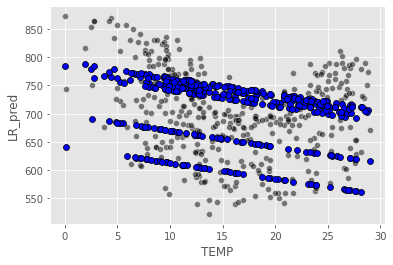

In [12]:
dfTR_eval['LR_pred'] = LR_fit.predict(X_train)
dfTS_eval['LR_pred'] = LR_fit.predict(X_test)

sns.scatterplot(data=dfTS_eval, x='TEMP', y='DEM', color='black', alpha=0.5)
sns.scatterplot(data=dfTS_eval, x='TEMP', y='LR_pred', color='blue', edgecolor='black')
plt.show()

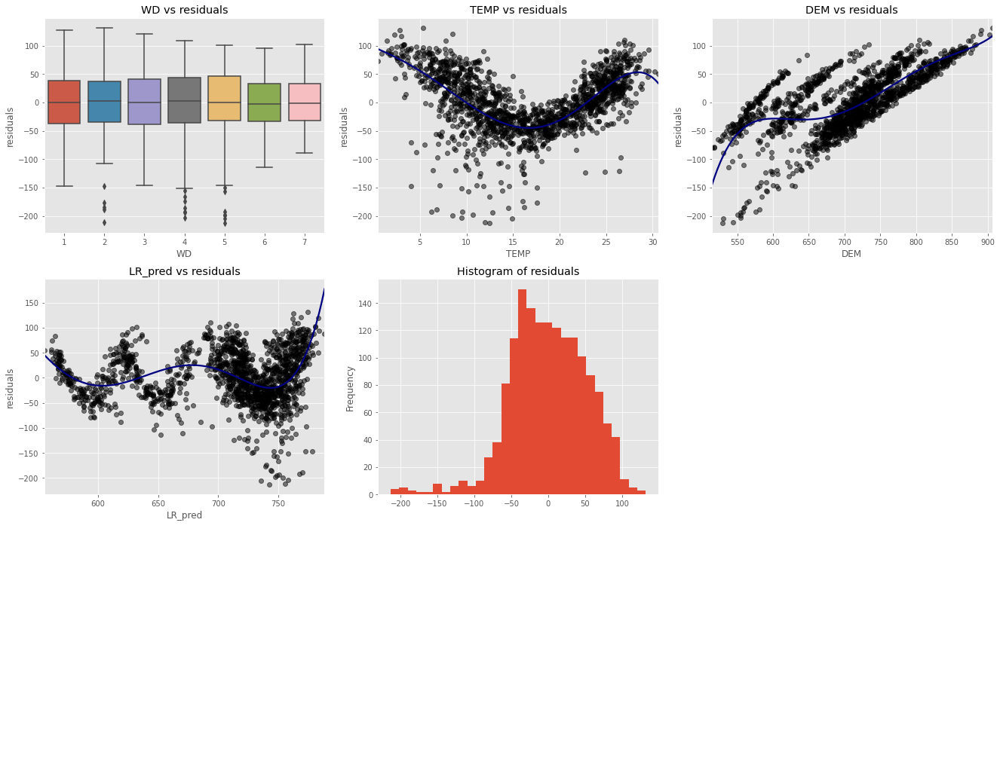

In [13]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR_pred', 'DEM')

In [14]:
# Create square of temperatures as input of the model
X_train_sq = X_train.copy()
X_test_sq = X_test.copy()
X_train_sq['TEMP_sq'] = X_train_sq['TEMP'] ** 2
X_test_sq['TEMP_sq'] = X_test_sq['TEMP'] ** 2

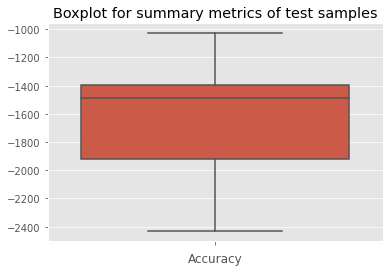

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('preprocessor',
                                        ColumnTransformer(transformers=[('num',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='median')),
                                                                                         ('scaler',
                                                                                          StandardScaler())]),
                                                                         ['TEMP',
                                                                          'TEMP_sq']),
                                                                        ('cat',
                                                                         Pipeline(steps=[('imputer',
                                                                                          SimpleImputer(strategy='constant')),
                                                                                         ('onehot',
                                                                                          OneHotEncoder(handle_unknown='ignore'))]),
                                                                         ['WD'])])),
                                       ('LR_model', LinearRegression())]),
             n_jobs=-1, param_grid={}, scoring='neg_mean_squared_error')

In [15]:
#################################################################################################
###################### LINEAR REGRESSION - SQUARE VARIABLE ######################################
#################################################################################################
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = X_train_sq.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = X_train_sq.select_dtypes(include=['category']).columns.values.tolist()
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])


# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

param = {} 
pipe = Pipeline([
            ('preprocessor', preprocessor),
            ('LR_model', LinearRegression())
        ])
# We use Grid Search Cross Validation to find the best parameter for the model in the grid defined 
nFolds = 10
LR2_fit = GridSearchCV(estimator=pipe, # Structure of the model to use
                       param_grid=param, # Defined grid to search in
                       n_jobs=-1, # Number of cores to use (parallelize)
                       scoring='neg_mean_squared_error', # RMSE https://scikit-learn.org/stable/modules/model_evaluation.html
                       cv=nFolds) # Number of Folds 
LR2_fit.fit(X_train_sq[numeric_features + categorical_features], y_train) # Search in grid

# Plot the cross validation score (accuracy) in the Grid Search
nFolds = 10
cv_errors = np.empty([nFolds,len(LR2_fit.cv_results_['split0_test_score'])])
for split in range(nFolds):
    cv_errors[split,:] = LR2_fit.cv_results_['split' + str(split) + '_test_score']
meanAcc = cv_errors.mean(0)
stdAcc = cv_errors.std(0)

scores_LR2 = meanAcc # Store cv-scores for later

ax = sns.boxplot(y=cv_errors).set_title('Boxplot for summary metrics of test samples')
plt.xlabel('Accuracy')
plt.show()
LR2_fit

In [16]:
RT.summaryLinReg(LR2_fit.best_estimator_, X_train_sq[numeric_features + categorical_features], y_train)  #information about the model trained

Residuals:
          Min         1Q    Median         3Q        Max
0 -231.114433 -17.679468  2.082775  23.471419  112.32897

Coefficients:
                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.728
Model:                            OLS   Adj. R-squared:                  0.727
Method:                 Least Squares   F-statistic:                     527.4
Date:                Tue, 18 Aug 2020   Prob (F-statistic):               0.00
Time:                        20:23:26   Log-Likelihood:                -8108.5
No. Observations:                1584   AIC:                         1.624e+04
Df Residuals:                    1575   BIC:                         1.628e+04
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025    

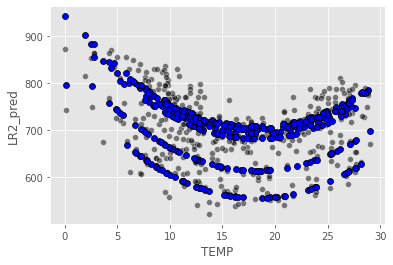

In [17]:
dfTR_eval['LR2_pred'] = LR2_fit.predict(X_train_sq)
dfTS_eval['LR2_pred'] = LR2_fit.predict(X_test_sq)

sns.scatterplot(data=dfTS_eval, x='TEMP', y='DEM', color='black', alpha=0.5)
sns.scatterplot(data=dfTS_eval, x='TEMP', y='LR2_pred', color='blue', edgecolor='black')
plt.show()

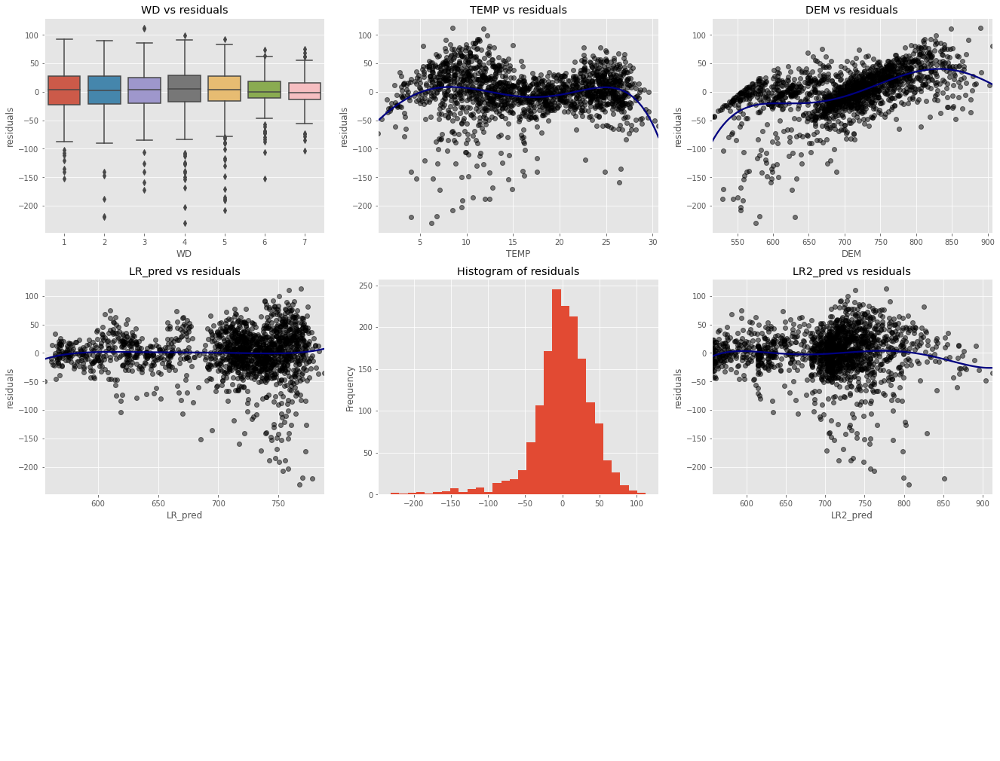

In [18]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'LR2_pred', 'DEM')

100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |##########################| Elapsed Time: 0:00:00 Time:  0:00:00
100% (5 of 5) |#########################

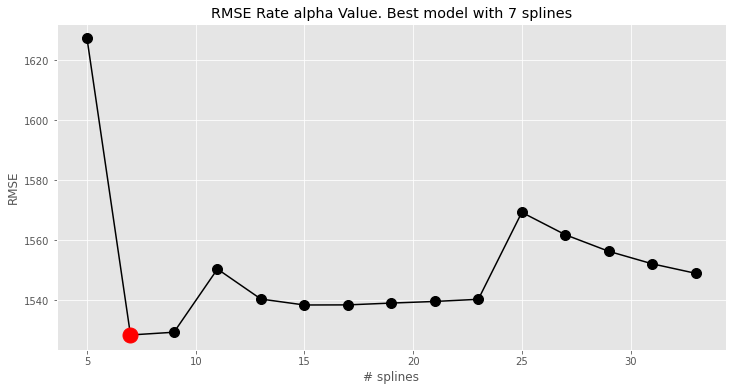

In [19]:
#################################################################################################
################################### GAM SPLINES REGRESSION ######################################
#################################################################################################
# Prepare the numeric variables by imputing by its median and scaling
# numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_features = X_train.select_dtypes(include=['int64','float64']).columns.values.tolist()
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

# Prepare the categorical variables by imputing by last value and encoding the categories
categorical_features = X_train.select_dtypes(include=['category']).columns.values.tolist()
categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='constant')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))])


# Create a preprocessor to perform the steps defined above
preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
        ])

X_transformed = preprocessor.fit_transform(X_train[numeric_features + categorical_features]).toarray()
X_test_transformed = preprocessor.transform(X_test[numeric_features + categorical_features]).toarray()

# We cannot use GridSearchCV as LinearGAM is not a scikit model
# So we make the grid ourselves
n_splines = np.arange(5, 35, 2)
lams = np.logspace(-3, 5, 5) # penalty term for splines
spline_orders = [3,4] # Order of splines can also be changed, n_splines must be always bigger than spline_order
errors = np.zeros((len(n_splines), len(spline_orders))) # Matrix for errors of each model
for indx_splines in range(len(n_splines)):
    for indx_spline_order in range(len(spline_orders)):
        GAM_fit = LinearGAM(n_splines=n_splines[indx_splines], spline_order=spline_orders[indx_spline_order]).gridsearch(X_transformed, y_train.to_numpy(), lam=lams)
        dem_pred = GAM_fit.predict(X_test_transformed) 
        errors[indx_splines, indx_spline_order] = mean_squared_error(y_test, dem_pred)

# Obtain the best model parameters
best_params_indexes = [arr[0] for arr in np.where(errors == np.amin(errors))]
best_params_ = {'n_splines': n_splines[best_params_indexes[0]], 'spline_order': spline_orders[best_params_indexes[1]]}
scores_gam = errors

print('\nBest model found with parameters:', best_params_)
print('Train the best model with these parameters')
# Train the best model
GAM_fit = LinearGAM(n_splines=best_params_['n_splines'], spline_order=best_params_['spline_order']).gridsearch(X_transformed, y_train.to_numpy(), lam=lams)

# Errors of the grid
plt.figure(figsize=(12, 6))
plt.plot(n_splines, scores_gam[:,np.where(errors == np.amin(errors))[1]], marker='o', markersize=10, color='black')
plt.plot(best_params_['n_splines'], np.amin(scores_gam), marker='o', markersize=15, color='red')
plt.title('RMSE Rate alpha Value. Best model with ' + str(best_params_['n_splines']) + ' splines')
plt.xlabel('# splines')
plt.ylabel('RMSE')
plt.show()

In [20]:
GAM_fit.summary()

LinearGAM                                                                                                 
=============================================== ==========================================================
Distribution:                        NormalDist Effective DoF:                                     12.1642
Link Function:                     IdentityLink Log Likelihood:                                -13123.3318
Number of Samples:                         1584 AIC:                                            26272.9919
                                                AICc:                                           26273.2294
                                                GCV:                                             1602.9306
                                                Scale:                                           1580.7886
                                                Pseudo R-Squared:                                   0.7394
Feature Function                  Lam

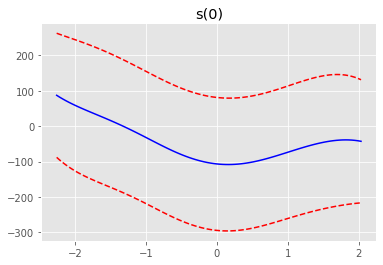

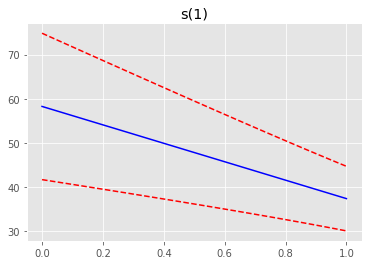

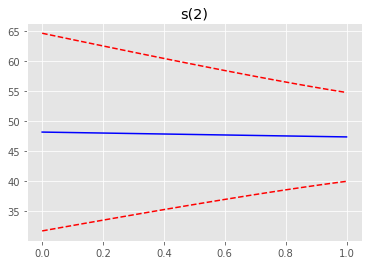

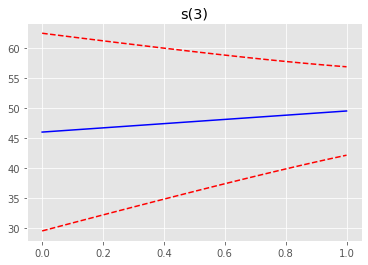

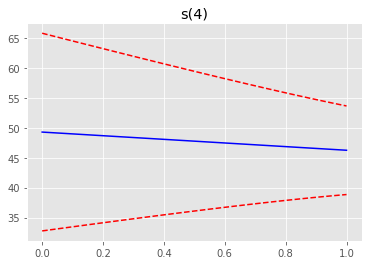

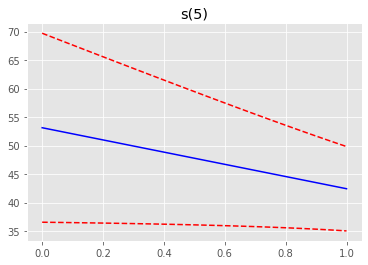

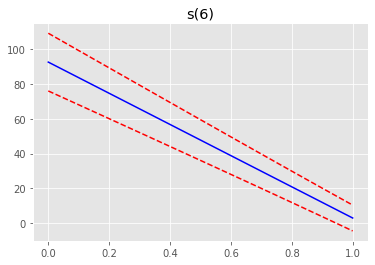

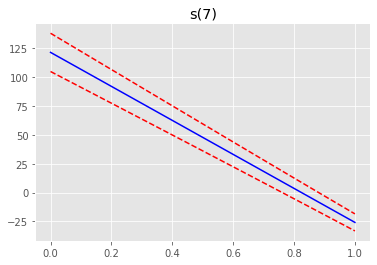

In [21]:
# Plot the splines separately
for i, term in enumerate(GAM_fit.terms):
    if term.isintercept:
        continue

    XX = GAM_fit.generate_X_grid(term=i)
    pdep, confi = GAM_fit.partial_dependence(term=i, X=XX, width=0.95)

    plt.figure()
    plt.plot(XX[:, term.feature], pdep, color='blue')
    plt.plot(XX[:, term.feature], confi, c='r', ls='--')
    plt.title(repr(term))
    plt.show()

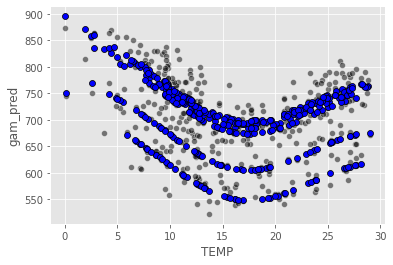

In [22]:
dfTR_eval['gam_pred'] = GAM_fit.predict(X_transformed)
dfTS_eval['gam_pred'] = GAM_fit.predict(X_test_transformed)

sns.scatterplot(data=dfTS_eval, x='TEMP', y='DEM', color='black', alpha=0.5)
sns.scatterplot(data=dfTS_eval, x='TEMP', y='gam_pred', color='blue', edgecolor='black')
plt.show()

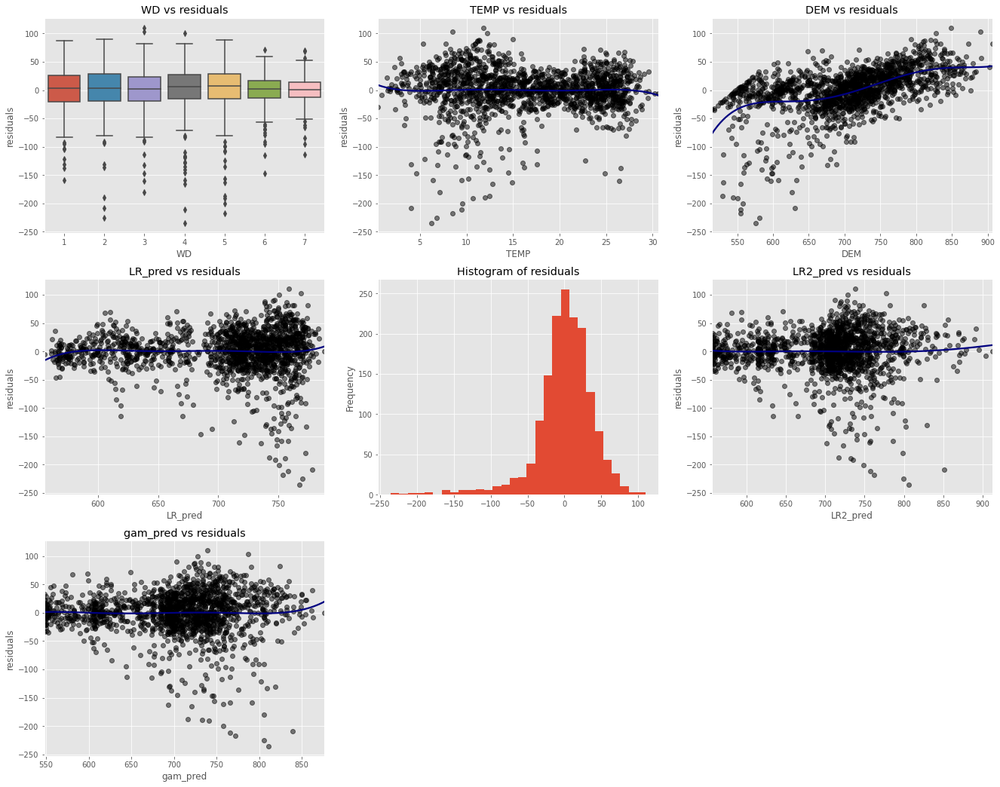

In [23]:
#Analysis of residuals
RT.plotModelDiagnosis(dfTR_eval, 'gam_pred', 'DEM')